<a href="https://colab.research.google.com/github/MaramMohamedd/NTI-Training/blob/main/Egyptian_Hieroglyphs.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import cv2
import os
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras import layers, models
from tensorflow.keras.applications.resnet50 import preprocess_input


In [ ]:
# 1. Install Kaggle API
!pip install kaggle

# 2. Upload your Kaggle API key (download it from your Kaggle account settings)
from google.colab import files
files.upload()  # upload kaggle.json here

# 3. Move kaggle.json to the right location
!mkdir -p ~/.kaggle
!mv kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

# 4. Download the dataset
!kaggle datasets download -d alexandrepetit881234/egyptian-hieroglyphs

# 5. Unzip it
!unzip egyptian-hieroglyphs.zip -d hieroglyphs


Saving kaggle.json to kaggle.json
Dataset URL: https://www.kaggle.com/datasets/alexandrepetit881234/egyptian-hieroglyphs
License(s): Attribution 4.0 International (CC BY 4.0)
  0% 0.00/10.4M [00:00<?, ?B/s]
100% 10.4M/10.4M [00:00<00:00, 902MB/s]
Archive:  egyptian-hieroglyphs.zip
  inflating: hieroglyphs/README.dataset.txt  
  inflating: hieroglyphs/README.roboflow.txt  
  inflating: hieroglyphs/test/100-12-_jpg.rf.fb1b9b584b6e16e1909c3e0829273685.jpg  
  inflating: hieroglyphs/test/100-16-_jpg.rf.01245963521559fa2e7c874464d6bfa8.jpg  
  inflating: hieroglyphs/test/100-40-_jpg.rf.fdfe2d3911c8439b4ab41e8a0e85f3e0.jpg  
  inflating: hieroglyphs/test/Her-16-_jpg.rf.0f04dba2d0770aa8805e845c4dc122de.jpg  
  inflating: hieroglyphs/test/Her-2-_jpg.rf.cace8206b14d8db8faf96e91630866ad.jpg  
  inflating: hieroglyphs/test/Her-21-_jpg.rf.ebd85d0b912ceb27579844ff78840f9a.jpg  
  inflating: hieroglyphs/test/Her-39-_jpg.rf.a26861c93574e0211b954a4a1be64a00.jpg  
  inflating: hieroglyphs/test/Woman-12

In [ ]:
import os

dataset_path = "hieroglyphs"  # folder where you unzipped it
for root, dirs, files in os.walk(dataset_path):
    print(f"{root} contains {len(files)} files")
class_names = sorted(os.listdir(dataset_path))
print("Number of classes:", len(class_names))
print("First 10 classes:", class_names[:10])




hieroglyphs contains 2 files
hieroglyphs/test contains 390 files
hieroglyphs/valid contains 779 files
hieroglyphs/train contains 2724 files
Number of classes: 5
First 10 classes: ['README.dataset.txt', 'README.roboflow.txt', 'test', 'train', 'valid']


In [ ]:
!find hieroglyphs -type f | grep -i ".txt"



hieroglyphs/README.dataset.txt
hieroglyphs/README.roboflow.txt


In [ ]:
!find hieroglyphs -type f | grep -Ei "\.csv$|\.json$|\.xml$|\.txt$"


hieroglyphs/README.dataset.txt
hieroglyphs/test/_annotations.csv
hieroglyphs/valid/_annotations.csv
hieroglyphs/README.roboflow.txt
hieroglyphs/train/_annotations.csv


In [ ]:
import pandas as pd
import cv2
import os

def prepare_classification_data(split):
    img_dir = f"hieroglyphs/{split}"
    ann_path = os.path.join(img_dir, "_annotations.csv")
    df = pd.read_csv(ann_path)

    save_dir = f"processed_{split}"
    os.makedirs(save_dir, exist_ok=True)

    for i, row in df.iterrows():
        img_path = os.path.join(img_dir, row['filename'])
        img = cv2.imread(img_path)

        xmin, ymin, xmax, ymax = int(row['xmin']), int(row['ymin']), int(row['xmax']), int(row['ymax'])
        crop = img[ymin:ymax, xmin:xmax]

        class_dir = os.path.join(save_dir, row['class'])
        os.makedirs(class_dir, exist_ok=True)

        save_path = os.path.join(class_dir, f"{i}.jpg")
        cv2.imwrite(save_path, crop)

prepare_classification_data("train")
prepare_classification_data("valid")
prepare_classification_data("test")


Number of classes: 95
First 5 classes: ['Board_Game', 'Bee', 'Fingre', 'Birth']
Total training images: 2723


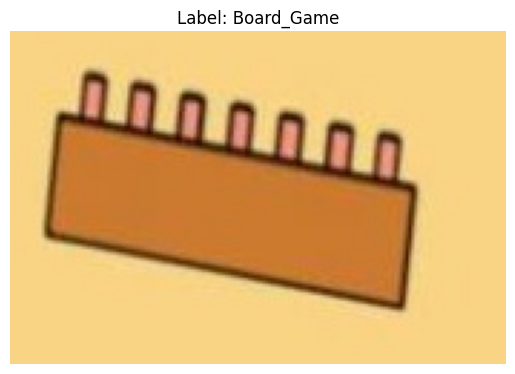

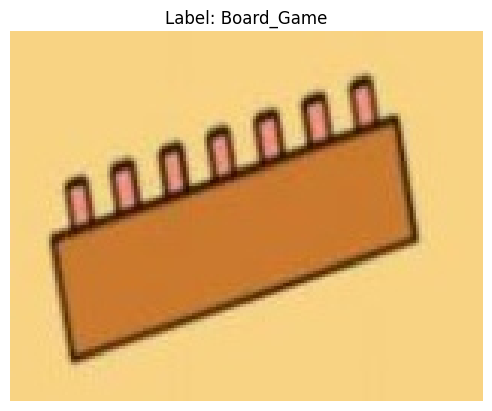

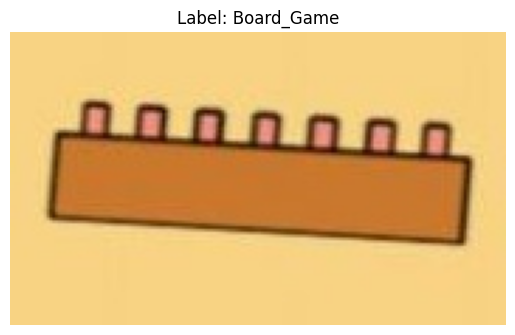

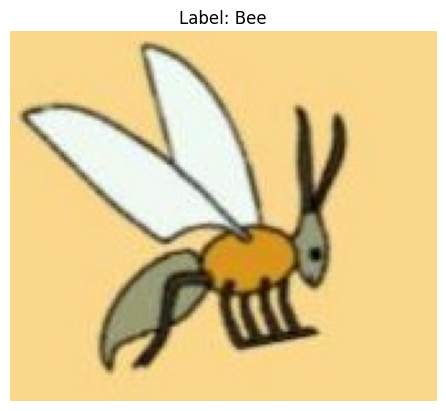

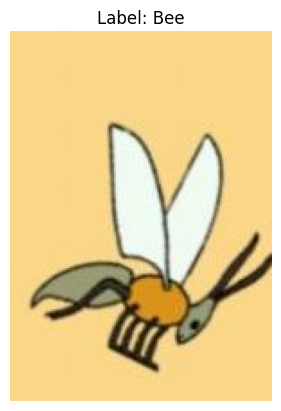

...

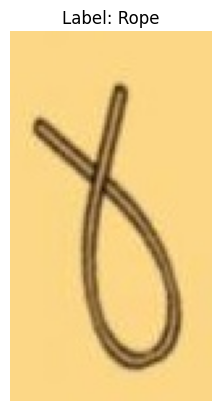

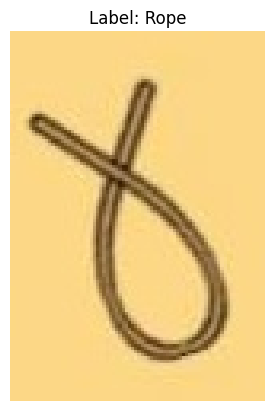

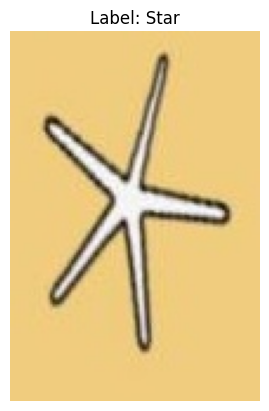

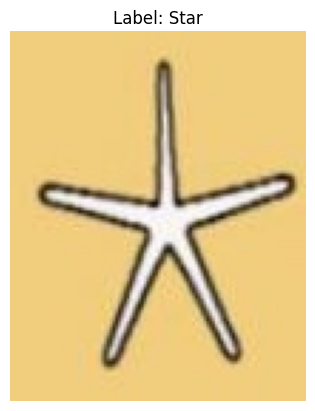

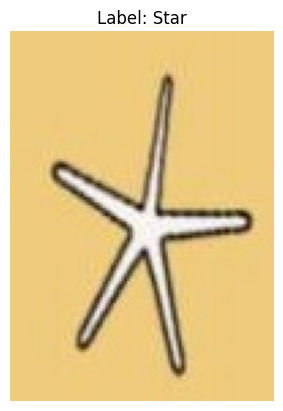

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt

base_path = "processed_train"
classes = os.listdir(base_path)
print("Number of classes:", len(classes))
print("First 5 classes:", classes[:4])

total_images = sum(len(os.listdir(os.path.join(base_path, c))) for c in classes)
print("Total training images:", total_images)

# Show a few sample images with their labels
for class_name in classes:
    class_dir = os.path.join(base_path, class_name)
    for img_name in os.listdir(class_dir)[:3]:  # show first 3 per class
        img_path = os.path.join(class_dir, img_name)
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        plt.imshow(img)
        plt.title(f"Label: {class_name}")
        plt.axis('off')
        plt.show()



In [ ]:
import tensorflow as tf

img_size = (224, 224)  # Resize for CNN input

train_ds = tf.keras.utils.image_dataset_from_directory(
    "processed_train",
    image_size=img_size,
    batch_size=32
)

val_ds = tf.keras.utils.image_dataset_from_directory(
    "processed_valid",
    image_size=img_size,
    batch_size=32
)

test_ds = tf.keras.utils.image_dataset_from_directory(
    "processed_test",
    image_size=img_size,
    batch_size=32
)

Found 2723 files belonging to 95 classes.
Found 778 files belonging to 95 classes.
Found 389 files belonging to 94 classes.


In [ ]:
from tensorflow.keras.applications.resnet50 import preprocess_input

train_ds = train_ds.map(lambda x, y: (preprocess_input(x), y))
val_ds = val_ds.map(lambda x, y: (preprocess_input(x), y))
test_ds = test_ds.map(lambda x, y: (preprocess_input(x), y))

In [ ]:
from tensorflow.keras.applications import ResNet50
from tensorflow.keras import layers, models

num_classes = len(classes)

base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
base_model.trainable = False

model = models.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.Dense(256, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(num_classes, activation='softmax')
])

model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
